In [1]:
from ultralytics import YOLO

In [2]:
import cv2
import matplotlib.pyplot as plt
import os

In [3]:
model = YOLO('weed-detector.pt')

In [4]:
source = "test/images/"
test_images = os.listdir(source)
paths = []
for img in test_images:
    paths.append(source+img)

['12122_jpg.rf.d7313af9bab0e80b7149ee0a3c32caf8.jpg', '12198_jpg.rf.a216dcc7b89a168893ccd130a89553ee.jpg', '12205_jpg.rf.ab3db8b3b513ffeae1e66458ae3b1df9.jpg', '301_jpg.rf.e0a19ebd17c5738934d155d4747cecba.jpg', '310_jpg.rf.a94f591dac795f5127eb44adb9887dae.jpg', '311_jpg.rf.c0ec2f814a7f68cab8d1c06ef9ec24a2.jpg', '317_jpg.rf.c7f0907204ab5da50ae42cf2336b2444.jpg', '32179_jpg.rf.9b7e752dea7e074755ddcab02e1778be.jpg', '32198_jpg.rf.21b61d44bbae489c49aa3e6152b0b606.jpg', '32215_jpg.rf.a8a307c17df98efe7fc4bc45312626b0.jpg', '32227_jpg.rf.e3e43b06dcec3f59abae3689b243bc31.jpg', '32242_jpg.rf.a4620635cc56d2702a572f9d0c80c3e0.jpg', '32264_jpg.rf.5ed191606674bb044db6c55d26ca3b69.jpg', '32288_jpg.rf.262788c3f4276945ae977f486d767fff.jpg', '32331_jpg.rf.07fb45618402497ec545cff4a6f0b94f.jpg', '32333_jpg.rf.e5bbd392adc00a9cb64cfd18e9238dbb.jpg', '32338_jpg.rf.5bf9865461d6189a8c3090806e2363b4.jpg', '32356_jpg.rf.a493fe0fbbb4ac1ad1b72f01bc599b52.jpg', '32421_jpg.rf.5b8eaaf2a558ba55d0af6ffb324a546e.jpg', 

In [5]:
from ultralytics.utils.plotting import Annotator
results = model.predict(paths)


0: 640x640 1 weed, 153.0ms
1: 640x640 2 weeds, 153.0ms
2: 640x640 1 weed, 153.0ms
3: 640x640 1 weed, 153.0ms
4: 640x640 3 weeds, 153.0ms
5: 640x640 2 weeds, 153.0ms
6: 640x640 4 weeds, 153.0ms
7: 640x640 9 weeds, 153.0ms
8: 640x640 4 weeds, 153.0ms
9: 640x640 3 weeds, 153.0ms
10: 640x640 2 weeds, 153.0ms
11: 640x640 2 weeds, 153.0ms
12: 640x640 3 weeds, 153.0ms
13: 640x640 2 weeds, 153.0ms
14: 640x640 3 weeds, 153.0ms
15: 640x640 4 weeds, 153.0ms
16: 640x640 1 weed, 153.0ms
17: 640x640 2 weeds, 153.0ms
18: 640x640 6 weeds, 153.0ms
19: 640x640 15 weeds, 153.0ms
20: 640x640 4 weeds, 153.0ms
21: 640x640 1 weed, 153.0ms
22: 640x640 8 weeds, 153.0ms
23: 640x640 5 weeds, 153.0ms
24: 640x640 (no detections), 153.0ms
25: 640x640 1 weed, 153.0ms
26: 640x640 6 weeds, 153.0ms
27: 640x640 9 weeds, 153.0ms
28: 640x640 10 weeds, 153.0ms
29: 640x640 17 weeds, 153.0ms
30: 640x640 15 weeds, 153.0ms
31: 640x640 8 weeds, 153.0ms
32: 640x640 4 weeds, 153.0ms
33: 640x640 9 weeds, 153.0ms
34: 640x640 3 wee

In [7]:
images = []
for result in results:
    img = cv2.imread(result.path)
    annotator = Annotator(img)
    for r in result:
        boxes = r.boxes
        for box in boxes:
            b = box.xyxy[0]  # Get box coordinates in (left, top, right, bottom) format
            c = box.cls
            annotator.box_label(b,model.names[int(c)] +" : {:.2f}".format(box.conf.cpu().numpy()[0]), (10, 13, 148))
    images.append(annotator.result())
    del annotator
# print(images)

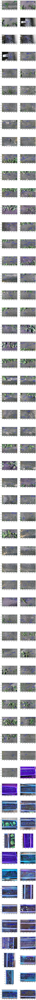

In [8]:
fig = plt.figure(figsize=(10,500))
for i in range(0,len(images)):
    fig.add_subplot(100 ,4 , i + 1)
    plt.imshow(images[i])


In [9]:
new_img = cv2.imread(paths[12])
annotator1 = Annotator(new_img)
res = model.predict(paths[12])

for r in res:
    boxes = r.boxes
    for box in boxes:
        b = boxes.xyxy[0]
        c = boxes.cls
        annotator1.box_label(b, model.names[int(c)])
res_img = annotator1.result()
cv2.imshow("Detection: ", res_img)
cv2.waitKey(0)
cv2.destroyAllWindows()

image 1/1 d:\Programs\aiot\weed-detection\test\images\32264_jpg.rf.5ed191606674bb044db6c55d26ca3b69.jpg: 384x640 3 weeds, 288.1ms
Speed: 46.9ms preprocess, 288.1ms inference, 29.1ms postprocess per image at shape (1, 3, 384, 640)


ValueError: only one element tensors can be converted to Python scalars